In [298]:
import matplotlib.pyplot as plt
import matplotlib.colors
import random
import numpy as np
import math
import sys

In [386]:
# Create instance of grid.
class Agent:
    def __init__(self, color, x, y):
        self.color = color
        self.colorId = colors.index(color)
        self.x = x
        self.y = y
        
    def __str__(self):
        return str(self.colorId)
    
    def getX(self):
        return self.x
    def getY(self): 
        return self.y
    def getCoord(self):
        return (self.x, self.y)
    def getColorId(self):
        return self.colorId
    def getColor(self):
        return self.color
    
    def setX(self, newX):
        self.x = newX
    def setY(self, newY):
        self.y = newY
    def setCoord(self, newX, newY):
        self.x = newX
        self.y = newY

In [548]:
class Grid:
    def __init__(self, length, width):
        self.length = length
        self.width = width
        self.population = length * width
        self.grid = None
        self.dict = {}
        self.districts = None
        self.colorMap = None
        self.method = None
        
    def initializeMap(self, method = 'uniform', num = 7, grid = None):
        self.method = method
        
        if num > 7 or num < 1: 
            raise ValueError("Argument num has to be an integer between 1 to 7. ")
            
        if method == "naive":
            self.grid = [[Agent('red', i, j) for j in range(self.width)] for i in range(self.length)]
            
        if method == "uniform":
            self.grid = []
            for i in range(self.length):
                templ = []
                for j in range(self.width):
                    value = random.uniform(0, 1)
                    cap = 1/num
                    count = 0
                    while (cap <= 1):
                        if value <= cap:
                            templ.append(Agent(colors[count], i, j))
                            break
                        else:
                            cap += 1/num
                            count += 1
                self.grid.append(templ)
                
        # Nebraska, enum is set to 2, with one huge concentration of a particular enum. 
        if method == 'Nebraska':
            self.colorMap = matplotlib.colors.ListedColormap(['tomato', 'royalblue'])
            
            cityRange = (self.length + self.width) / 2
            cityCenter_x = random.randint(0, self.length)
            cityCenter_y = random.randint(0, self.width)
            self.grid = []
            self.dict['red'] = 0
            self.dict['blue'] = 0
            for i in range(self.length):
                templ = []
                for j in range(self.width):
                    # the distance between this agent and the city center. 
                    distance = math.sqrt((abs(i - cityCenter_x) ** 2) + (abs(j - cityCenter_y) ** 2))
                    prob = random.uniform(0, 1)
                    lratio = (self.length - distance)/self.length
                    wratio = (self.width - distance) / self.width
                    amplifier = 1.2
                    threshold = lratio * wratio * amplifier

                    if prob < threshold: 
                        templ.append(Agent(colors[2], i, j))
                        self.dict['blue'] += 1
                    else:
                        templ.append(Agent(colors[1], i, j))
                        self.dict['red'] += 1
                self.grid.append(templ)
                    
    def __str__(self):
        return str([[str(self.grid[i][j]) for j in range(self.width)] for i in range(self.length)])

    def displayGrid(self):
        plt.imshow(self.getColorIds(), cmap = self.colorMap)
        plt.show()
    
    def getColorIds(self):
        return [[self.grid[i][j].getColorId() for j in range(self.width)] for i in range(self.length)]
    
    def getSummary(self, percentage = False):
        if not percentage:
            return self.dict
        tempDict = self.dict
        sumCount = sum(tempDict.values())
        for i in tempDict:
            tempDict[i] /= sumCount
        return tempDict

    def drawDistricts(self, numOfDistrict):
        
        colorList = ['white', 'tomato', 'royalblue']
        self.districts = [District(self.length, self.width, 2, colorList) for i in range(numOfDistrict)]
        districtCenters = []
        for i in range(numOfDistrict):
            districtCenters.append((0 + i * self.length/numOfDistrict, 0 + i * self.width/numOfDistrict))
        
        minIdx = -1
        lastDistance = 999999
        for i in range(self.length):
            for j in range(self.width):
                for k in range(len(districtCenters)):
                    (x, y) = districtCenters[k]
                    dist = (abs(x - i)**2 + abs(y - j)**2)**0.5
                    if dist < lastDistance:
                        minIdx = k
                    lastDistance = dist
                self.districts[minIdx].addMember(i, j, self.grid[i][j].getColorId(), check = False)
        
        balanced = self.districtsHasBalancedPopulation()
        while(not balanced):
            # find district with min and max, if they are adjacent, average out their population
            # repeat this process until all districts are balanced. 
            
            # sort districtsId by their population
            ids = [i for i in range(len(self.districts))]
            populationList = []
            for district in self.districts:
                populationList.append(district.getCount())
            ids = [x for _,x in sorted(zip(populationList,ids))]
            print(ids, populationList)
            
            for minPointer in range(0, len(self.districts)):
                for maxPointer in range(len(self.districts)-1, 0):
                    minId = ids[minPointer]
                    maxId = ids[maxPointer]
                    if self.districts[minId].getCount() > self.districts[maxId].getCount():
                        temp = minId
                        minId = maxId
                        maxId = temp
                        
                    self.balanceTwoDistrictsIfAdjacent(minId, maxId)    
        
    def districtsHasBalancedPopulation(self):
        sum = 0
        for district in self.districts:
            sum += district.getCount()
        average = sum / len(self.districts)
        diff = 0
        for district in self.districts:
            diff += abs(district.getCount() - average)
        if diff >= 0.05 * self.population:
            return False
        return True
            
    
    def balanceTwoDistrictsIfAdjacent(self, minId, maxId):
        self.districts[maxId].balanceWithDistrict(self.districts[minId])
        
    def showDistrict(self, index):
        self.districts[index].show()
        
    def getDistrictSummary(self, index):
        return self.districts[index].getSummary(percentage = True)
        
    def districtData(self, index):
        return str(self.districts[index])

In [549]:
class District:
    def __init__(self, length, width, numOfColor, colorList):
        self.length = length # x
        self.width = width # y
        self.tiles = [[0 for j in range(self.width)] for i in range(self.length)]
        self.count = 0
        self.summary = dict()
        self.colorList = colorList
        
    def addMember(self, x, y, colorId, check = True):
        if not check or newMemberIsPhysicallyContinuous(self, x, y):
            self.tiles[x][y] = colorId
            self.count +=1 
            if colorId not in self.summary:
                self.summary[colorId] = 1
            else: 
                self.summary[colorId] += 1
            return True
        else:
            return False
        
    def newMemberIsPhysicallyContinous(self, x, y):
        if not (x >= 0 and x < self.length) or not (y >= 0 and y < self.width): 
            return False
        if (x + 1 < self.length and self.tiles[x + 1][y] >= 1):
            return True
        if (x - 1 >= 0 and self.tiles[x-1][y] >= 1):
            return True
        if (y + 1 < self.width and self.tiles[x][y+1] >= 1):
            return True
        if (y-1 >= 0 and self.tiles[x][y-1] >= 1):
            return True
        return False
        
    def isPhysicallyContinuous(self):
        for i in range(self.length):
            for j in range(self.width):
                # if this tile is occupied, then expect at least one adjacent tile is occupied as well
                if self.tiles[x][y] >= 1:
                    adjacent = False
                    if (x + 1 < self.length and self.tiles[x + 1][y] >= 1):
                        adjacent = True
                    if (x - 1 >= 0 and self.tiles[x-1][y] >= 1):
                        adjacent = True
                    if (y + 1 < self.width and self.tiles[x][y+1] >= 1):
                        adjacent = True
                    if (y-1 >= 0 and self.tiles[x][y-1] >= 1):
                        adjacent = True
                    if not adjacent: 
                        return False
        return True
                    

    def ejectMember(self, x, y):
        if (x < 0 or x > self.length or y < 0 or y > self.width):
            return None
        
        if self.tiles[x][y] == 0:
            return None
        else: 
            temp = self.tiles[x][y]
            self.tiles[x][y] = 0
            if self.isPhysicallyContinuous():
                return temp
            else:
                self.tiles[x][y] = temp
                return None
    
    def show(self):
        actualColorList = []
        for i in range(len(self.summary) + 1):
            actualColorList.append(self.colorList[i])
        plt.imshow(self.tiles, cmap=matplotlib.colors.ListedColormap(actualColorList))
        plt.show()
    
    def getSummary(self, percentage = False):
        if not percentage:
            return self.summary
        else:
            tempDict = self.summary
            sumCount = sum(tempDict.values())
            for i in tempDict:
                tempDict[i] /= sumCount
            return tempDict
    
    def balanceTwoDistrictsIfAdjacent(self, district2):
        while(self.getCount() > district2.getCount()):
            emittedMember = self.ejectMemberAdjacentToDistrict(self, district)
            if emittedMember == None:
                return False
            
        # while two district has a big population difference greater than 1 or simply nolonger physcially continous
        # find a member inside this district that is adjacent to district2
        # see if myself is still physically continuous after removing this district
        # remove this member from myself and add it to district2. 
    
    def ejectMemberAdjacentToDistrict(self, district):
        # find a member that is adjacent to this district. 
        emittedMember = self.findMemberAdjacentTodistrict()
    
    def findMemberAdjacent
    
    def getCount(self):
        return self.count
    
    def __str__(self):
        return str([[self.tiles[i][j] for j in range(self.width)] for i in range(self.length)])

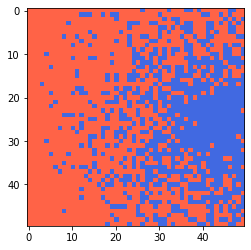

{'red': 0.6448, 'blue': 0.3552}
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430,

[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] 

[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] 

[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] 

[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] 

[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] 

[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] 

[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 

[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] 

[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] 

[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 

[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] 

[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] 

[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] 

[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] 

[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] 

[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] 

[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] 

[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] [66, 430, 828, 770, 406]
[0, 4, 1, 3, 2] 

KeyboardInterrupt: 

In [550]:
#Nebraska
NebraskaGrid = Grid(50, 50)
NebraskaGrid.initializeMap('Nebraska')

NebraskaGrid.displayGrid()

print(NebraskaGrid.getSummary(percentage = True))

NebraskaGrid.drawDistricts(5)
for i in range(5):
    NebraskaGrid.showDistrict(i)
    print(NebraskaGrid.getDistrictSummary(i))

In [471]:
colors = ['royalblue', 'red', 'yellow', 'lightgreen', 'pink', 'brown', 'gold']
colormap = matplotlib.colors.ListedColormap(colors) 
# print(colormap.colors)
# colors = ['royalblue', 'red']
# plt.imshow([[0, 1]], cmap=colormap)
# plt.show()
# colors = ['royalblue', 'red', 'yellow', 'lightgreen']
# plt.imshow([[0, 1, 2, 3]], cmap=colormap)
# plt.show()
# colors = ['royalblue', 'red', 'yellow', 'lightgreen', 'pink', 'brown']
# plt.imshow([[0, 1, 2, 3, 4, 5]], cmap=colormap)
# plt.show()
# colors = ['royalblue', 'red', 'yellow', 'lightgreen', 'pink', 'brown', 'gold']
# plt.imshow([[0, 1, 2, 3, 4, 5, 6]], cmap=colormap)

In [ ]:
plt.imshow([0, 1, 2, 3, 4, 5, 6, 7], cmap=colormap)

[['0', '0', '0', '0', '0', '0', '0', '0', '0', '0'], ['0', '0', '0', '0', '0', '0', '0', '0', '0', '0'], ['0', '0', '0', '0', '0', '0', '0', '0', '0', '0'], ['0', '0', '0', '0', '0', '0', '0', '0', '0', '0'], ['0', '0', '0', '0', '0', '0', '0', '0', '0', '0'], ['0', '0', '0', '0', '0', '0', '0', '0', '0', '0'], ['0', '0', '0', '0', '0', '0', '0', '0', '0', '0'], ['0', '0', '0', '0', '0', '0', '0', '0', '0', '0'], ['0', '0', '0', '0', '0', '0', '0', '0', '0', '0'], ['0', '0', '0', '0', '0', '0', '0', '0', '0', '0']]
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0, 0]]


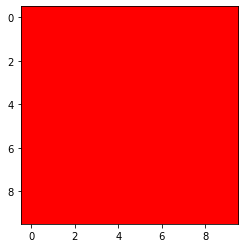

In [157]:
#uniform
NaiveGrid = Grid(10, 10)
NaiveGrid.initializeMap('naive')
print(NaiveGrid)
print(NaiveGrid.getColorIds())
plt.imshow(NaiveGrid.getColorIds(), cmap=colormap)

[[5, 3, 3, 4, 2, 0, 5, 6, 6, 5], [5, 2, 3, 0, 5, 4, 1, 5, 3, 3], [4, 0, 6, 1, 1, 2, 1, 1, 5, 1], [1, 4, 2, 6, 5, 3, 3, 3, 1, 2], [0, 3, 6, 6, 5, 4, 1, 4, 1, 3], [3, 3, 2, 4, 5, 4, 3, 6, 4, 4], [0, 1, 1, 1, 0, 4, 0, 2, 4, 5], [1, 6, 5, 3, 3, 1, 1, 4, 2, 4], [3, 4, 4, 0, 5, 3, 2, 5, 5, 6], [1, 1, 4, 3, 2, 2, 1, 2, 2, 3]]


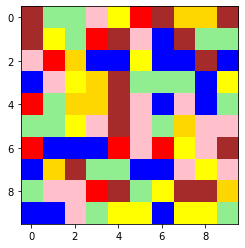

In [226]:
#uniform
UniformGrid = Grid(10, 10)
UniformGrid.initializeMap('uniform', 7)
print(UniformGrid.getColorIds())
plt.imshow(UniformGrid.getColorIds(), cmap=colormap)